# Objective
* Review camera locations in Calgary and find correlation to accident counts

# Import Libraries

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import Grid_Analysis as ga
import Accidents as acc


# Import Sign DataSet

In [7]:
df = pd.read_csv("Data/Traffic_Signs.csv")
df['BLADE_TYPE'].value_counts()

Street Name             42762
Parking Restrictions    33794
Regulatory              23315
Warning                 17953
Stop                    12856
Timed Parking           10682
Playground               9743
Yield                    9406
Pedestrian               8908
Guide / Information      7588
Residential Parking      5875
Disabled Parking         4522
Speed                    4355
Bicycle / Pathway        4199
Park Plus                3808
Snow Route               2761
Loading Zone             2141
School                   2019
Overhead Guide            450
Hospital                  139
Halo                       10
Name: BLADE_TYPE, dtype: int64

In [8]:
#Drop unimportant signs, keep only necessary columns, reset index.

df=df[df['BLADE_TYPE'].isin(['Speed','School','Playground','Yield','Stop'])]
data=[df.BLADE_TYPE,df.SGN_COUNT_NO,df.POINT]
df = pd.concat(data,axis=1)
df= df.rename(columns={'BLADE_TYPE':"sign_type", 'SGN_COUNT_NO':'sign_count','POINT':'coordinate'})
df= df.reset_index(drop=True)
df

,sign_type,sign_count,coordinate
0,Yield,0.0,POINT (-114.094374668366 50.97932823916)
1,Stop,2.0,POINT (-114.050415908751 51.047132018374)
2,Stop,0.0,POINT (-114.109678007362 51.023129992642)
3,Stop,4.0,POINT (-114.050685051172 51.047205670797)
4,Yield,0.0,POINT (-114.09441056135 50.979431963661)
...,...,...,...
38374,Stop,3.0,POINT (-114.197288584804 51.093980736144)
38375,Stop,2.0,POINT (-114.048354211088 51.090142270424)
38376,Playground,1.0,POINT (-114.216564811046 51.059319356325)
38377,Speed,1.0,POINT (-113.958452740811 50.969602409926)


In [9]:
#Condition coordinate data such that the format is string : lat long to use ga.methods
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).replace("POINT (","")).replace(")","")
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).strip(')'))
df

,sign_type,sign_count,coordinate
0,Yield,0.0,-114.094374668366 50.97932823916
1,Stop,2.0,-114.050415908751 51.047132018374
2,Stop,0.0,-114.109678007362 51.023129992642
3,Stop,4.0,-114.050685051172 51.047205670797
4,Yield,0.0,-114.09441056135 50.979431963661
...,...,...,...
38374,Stop,3.0,-114.197288584804 51.093980736144
38375,Stop,2.0,-114.048354211088 51.090142270424
38376,Playground,1.0,-114.216564811046 51.059319356325
38377,Speed,1.0,-113.958452740811 50.969602409926


In [10]:
#Create longitude and latitude columns for ploting distribution
df["coordinate"]=df["coordinate"].apply(lambda x: str(x).split(' '))
df[['longitude','latitude']] = pd.DataFrame(df.coordinate.tolist(), index= df.index)
df['longitude'] = df['longitude'].str.strip('[]()').astype(float)
df['latitude'] = df['latitude'].str.strip('[]()').astype(float)
df

,sign_type,sign_count,coordinate,longitude,latitude
0,Yield,0.0,"[-114.094374668366, 50.97932823916]",-114.094375,50.979328
1,Stop,2.0,"[-114.050415908751, 51.047132018374]",-114.050416,51.047132
2,Stop,0.0,"[-114.109678007362, 51.023129992642]",-114.109678,51.023130
3,Stop,4.0,"[-114.050685051172, 51.047205670797]",-114.050685,51.047206
4,Yield,0.0,"[-114.09441056135, 50.979431963661]",-114.094411,50.979432
...,...,...,...,...,...
38374,Stop,3.0,"[-114.197288584804, 51.093980736144]",-114.197289,51.093981
38375,Stop,2.0,"[-114.048354211088, 51.090142270424]",-114.048354,51.090142
38376,Playground,1.0,"[-114.216564811046, 51.059319356325]",-114.216565,51.059319
38377,Speed,1.0,"[-113.958452740811, 50.969602409926]",-113.958453,50.969602


# Analyze

## Distribution of Traffic Signs

In [11]:
base_coordinates = [51.044270, -114.062019]
map = folium.Map(location=base_coordinates)

sign_cluster = MarkerCluster().add_to(map)

for idx, row in df.iterrows():
    folium.Marker([row['latitude'], row['longitude']],
                 popup='sign').add_to(sign_cluster)
map

## Accidents Distribution

In [12]:
accident_counts = acc.get_accident_counts_by_location()
accident_counts

,Accident Count
"(50.994156675722, -114.039173086226)",68
"(51.048859876417, -114.019434255636)",65
"(51.067379869342, -114.028551292521)",56
"(50.996389267837, -114.101595818037)",48
"(51.000997134752, -114.121071289426)",39
...,...
"(51.043236542711, -113.969999173787)",1
"(50.994572598728, -114.076617075723)",1
"(51.095696585485, -113.985299696443)",1
"(50.950722757397, -114.119348374395)",1


In [13]:
base_coordinates = [51.044270, -114.062019]
map = folium.Map(location=base_coordinates)

accident_cluster = MarkerCluster().add_to(map)

for idx, row in accident_counts.iterrows():
    loc = idx.strip('()').split(',')
    loc = [float(i) for i in loc]
    folium.Marker(loc, popup='accident').add_to(accident_cluster)

map

## Scatter Plot

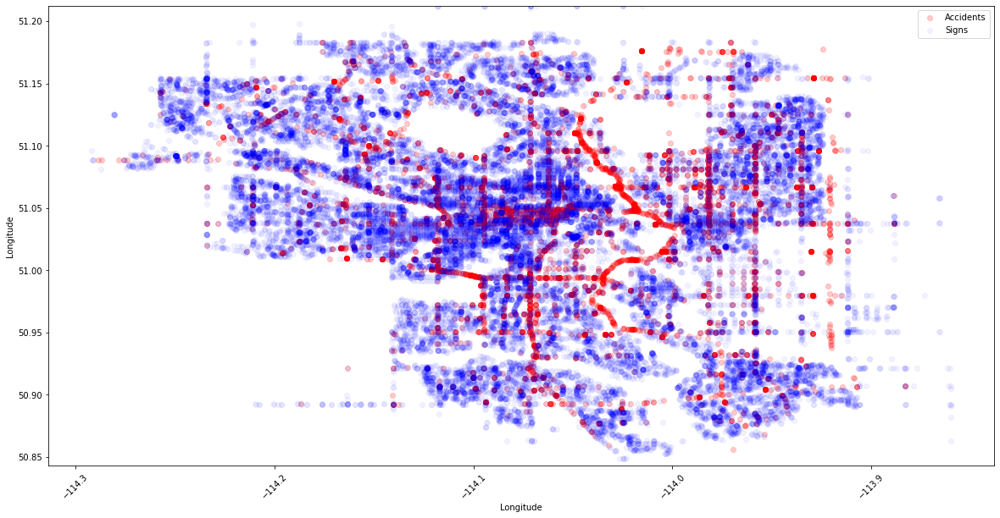

In [14]:
accidents = acc.extract_accidents('Data/Traffic_Incidents.csv', '2018')

plt.figure(figsize=(20,10))
plt.scatter(x = 'longitude', y = 'latitude', data = accidents, label = 'Accidents', c='r', alpha=0.2)
plt.scatter(x = 'longitude', y = 'latitude', data=df, label = 'Signs', c='b', alpha=0.05)
plt.ylim(50.842822, 51.212425)
plt.xticks(rotation=45)
plt.xlabel('Longitude')
plt.ylabel('Longitude')
plt.legend()

# Conclusions
There is no clear correlation between traffic camera location and the number of accidents. 